In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"f1atnote","key":"b31c6a1b0663c414dff524a4d12a131b"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!pip install -q torch torchvision torchaudio
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 873.6/873.6 kB 19.8 MB/s eta 0:00:00


In [ ]:
!kaggle datasets list

ref                                                              title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
---------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
lainguyn123/student-performance-factors                          Student Performance Factors                          94KB  2024-09-02 10:53:57          12019        255  1.0              
owm4096/laptop-prices                                            Laptop Prices                                        25KB  2024-09-09 12:43:01           2899         53  1.0              
waqi786/global-black-money-transactions-dataset                  🕵️‍♂️ Global Black Money Transactions Dataset 📊     298KB  2024-09-15 10:56:34           1077         22  1.0              
taweilo/mba-admission-dataset                          

In [ ]:
!kaggle datasets download -d dasmehdixtr/drone-dataset-uav

Dataset URL: https://www.kaggle.com/datasets/dasmehdixtr/drone-dataset-uav
License(s): copyright-authors
 99% 711M/716M [00:10<00:00, 91.3MB/s]
100% 716M/716M [00:10<00:00, 68.9MB/s]


In [ ]:
!unzip drone-dataset-uav.zip -d drone-dataset-uav

Archive:  drone-dataset-uav.zip
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00088.png  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00088.xml  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00117.png  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00117.xml  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00204.png  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00204.xml  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00233.png  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00233.xml  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00262.png  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00262.xml  
  inflating: drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00291.png  
  inflating: drone-dataset-uav/da

In [ ]:
import numpy as np
import pandas as pd

import os
for dirname, _, filenames in os.walk('/content/drone-dataset-uav'):
  for filename in filenames:
    print(os.path.join(dirname, filename))

/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/pic_434.jpg
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto04467.png
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto01973.xml
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto00320.xml
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto07454.xml
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/pic_240.xml
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/pic_225.xml
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/pic_250.jpg
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/foto14617.png
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/pic_560.jpg
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/pic_301.jpg
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format/moto00958.xml
/content/drone-dataset-uav/dataset_xml_format/dataset_xml_format

In [ ]:
from pathlib import Path
import os

DATA_DIR = Path("/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt")
print(len(os.listdir(DATA_DIR)))

2719


In [ ]:
images = sorted(list(DATA_DIR.glob("*.jpg")))
print("Total images: ", len(images))
images[:5]

Total images:  1359


[PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0001.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0003.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0004.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0005.jpg'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0006.jpg')]

In [ ]:
labels = sorted(list(DATA_DIR.glob("*.txt")))
print("Total labels: ", len(labels))
labels[:5]

Total labels:  1360


[PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0001.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0003.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0004.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0005.txt'),
 PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/0006.txt')]

In [ ]:
#There is difference b/w count of labels and images, finding the redundant label
set([label_path.stem for label_path in labels]) - set([image_path.stem for image_path in images])

{'classes'}

In [ ]:
# Reading classes.txt
with open(DATA_DIR/"classes.txt", 'r') as f:
    print(f.read())

drone



In [ ]:
FILE_TO_REMOVE = DATA_DIR / "classes.txt"
labels.remove(FILE_TO_REMOVE)

In [ ]:
print("Images: ", len(images), " Labels: ", len(labels))

Images:  1359  Labels:  1359


In [ ]:
#generating yolo formats
DATA_DIR = Path("Data")
TRAIN_DIR = DATA_DIR / "train"
TEST_DIR = DATA_DIR / "test"
VALIDATION_DIR = DATA_DIR / "val"
os.makedirs(TRAIN_DIR/ "images")
os.makedirs(TRAIN_DIR/ "labels")
os.makedirs(TEST_DIR/ "images")
os.makedirs(TEST_DIR/ "labels")
os.makedirs(VALIDATION_DIR/ "images")
os.makedirs(VALIDATION_DIR/ "labels")

In [ ]:
# Splitting data into train and test data
from sklearn.model_selection import train_test_split

X_train,X_temp,y_train,y_temp = train_test_split(images, labels, test_size = 0.2)
X_val,X_test,y_val,y_test = train_test_split(X_temp, y_temp, test_size = 0.2)

In [ ]:
print("Train image count: ", len(X_train))
print("Validation image count: ", len(X_val))
print("Test image count: ", len(X_test))

Train image count:  1087
Validation image count:  217
Test image count:  55


In [ ]:
X_train[:5], y_train[:5]

([PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_480.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/foto15023.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_536.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/scene00466.jpg'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_856.jpg')],
 [PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_480.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/foto15023.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_536.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/scene00466.txt'),
  PosixPath('/content/drone-dataset-uav/drone_dataset_yolo/dataset_txt/pic_856.txt')])

In [ ]:
import shutil
from tqdm.notebook import tqdm

def copyfiles(files, dest):
    print(f"Copying files to {dest}")
    for file in tqdm(files):
        shutil.copy(file, dest)

copyfiles(X_train, TRAIN_DIR/ "images")
copyfiles(y_train, TRAIN_DIR/ "labels")

copyfiles(X_test, TEST_DIR/ "images")
copyfiles(y_test, TEST_DIR/ "labels")

copyfiles(X_val, VALIDATION_DIR/ "images")
copyfiles(y_val, VALIDATION_DIR/ "labels")

Copying files to Data/train/images


  0%|          | 0/1087 [00:00<?, ?it/s]

Copying files to Data/train/labels


  0%|          | 0/1087 [00:00<?, ?it/s]

Copying files to Data/test/images


  0%|          | 0/55 [00:00<?, ?it/s]

Copying files to Data/test/labels


  0%|          | 0/55 [00:00<?, ?it/s]

Copying files to Data/val/images


  0%|          | 0/217 [00:00<?, ?it/s]

Copying files to Data/val/labels


  0%|          | 0/217 [00:00<?, ?it/s]

In [ ]:
data_yaml = """
train: /content/Data/train/images
test: /content/Data/test/images
val: /content/Data/val/images

names:
  0: drone
"""

with open(DATA_DIR/"data.yaml", "w") as f:
    f.write(data_yaml)

In [ ]:
os.listdir(DATA_DIR)

['test', 'data.yaml', 'val', 'train']

In [ ]:
with open(DATA_DIR/"data.yaml", "r") as f:
    print(f.read())


train: /content/Data/train/images
test: /content/Data/test/images
val: /content/Data/val/images

names:
  0: drone



In [ ]:
!pip uninstall wandb -y
!pip -q install ultralytics

In [ ]:
from ultralytics import YOLO

model = YOLO("yolov8s.pt")

100%|██████████| 21.5M/21.5M [00:00<00:00, 247MB/s]


In [ ]:
model.info()

YOLOv8s summary: 225 layers, 11,166,560 parameters, 0 gradients, 28.8 GFLOPs


(225, 11166560, 0, 28.816844800000002)

In [ ]:
# Training yolov8n model
results = model.train(
    data = DATA_DIR/"data.yaml",
    epochs = 100,
    imgsz = 640
)

Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=Data/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True,

100%|██████████| 755k/755k [00:00<00:00, 25.9MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 6.25M/6.25M [00:00<00:00, 108MB/s]


AMP: checks passed ✅


train: Scanning /content/Data/train/labels... 1087 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1087/1087 [00:00<00:00, 1161.89it/s]

train: WARNING ⚠️ /content/Data/train/images/pic_722.jpg: corrupt JPEG restored and saved
train: New cache created: /content/Data/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/Data/val/labels... 217 images, 0 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:00<00:00, 617.45it/s]

val: New cache created: /content/Data/val/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.06G      1.521      2.239      1.667         35        640: 100%|██████████| 68/68 [00:36<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        242      0.465      0.579      0.513      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.01G      1.571      1.513        1.7         41        640: 100%|██████████| 68/68 [00:32<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]

                   all        217        242      0.176      0.322      0.117      0.033



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      4.05G      1.623      1.485      1.743         42        640: 100%|██████████| 68/68 [00:32<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.39it/s]

                   all        217        242       0.29      0.413      0.294     0.0909



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      4.01G      1.627      1.459      1.748         36        640: 100%|██████████| 68/68 [00:32<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]

                   all        217        242      0.341       0.18       0.19     0.0817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      3.82G      1.577      1.361      1.676         40        640: 100%|██████████| 68/68 [00:34<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.68it/s]

                   all        217        242      0.626      0.426      0.501      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      4.01G      1.506      1.287      1.669         39        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.57it/s]

                   all        217        242      0.623      0.594      0.597      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      4.01G      1.464      1.259      1.609         34        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.47it/s]

                   all        217        242       0.83      0.786      0.842      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      4.02G      1.453      1.203      1.591         38        640: 100%|██████████| 68/68 [00:33<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]

                   all        217        242      0.821       0.76      0.774      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      4.01G      1.433       1.19      1.574         40        640: 100%|██████████| 68/68 [00:31<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        217        242      0.812      0.748      0.822      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      4.01G      1.406      1.141       1.56         45        640: 100%|██████████| 68/68 [00:32<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        242      0.757      0.745      0.787      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      4.01G      1.396      1.113      1.545         66        640: 100%|██████████| 68/68 [00:34<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.35it/s]

                   all        217        242      0.777      0.734      0.763      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      4.01G       1.39      1.113      1.545         33        640: 100%|██████████| 68/68 [00:34<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.62it/s]

                   all        217        242      0.831      0.811      0.874       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.01G      1.347      1.049      1.509         32        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.60it/s]

                   all        217        242      0.793      0.806      0.862      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      4.01G      1.329      1.022        1.5         46        640: 100%|██████████| 68/68 [00:34<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.43it/s]

                   all        217        242      0.824      0.719      0.769      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.01G      1.316     0.9904       1.48         34        640: 100%|██████████| 68/68 [00:33<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.59it/s]

                   all        217        242      0.784      0.781      0.802      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.01G      1.317      1.011      1.488         51        640: 100%|██████████| 68/68 [00:33<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]

                   all        217        242      0.853      0.841      0.866      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.01G      1.309     0.9701      1.472         32        640: 100%|██████████| 68/68 [00:34<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.55it/s]

                   all        217        242      0.881      0.829      0.895       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.01G      1.272     0.9509      1.462         40        640: 100%|██████████| 68/68 [00:36<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.63it/s]

                   all        217        242      0.872      0.864       0.91       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.01G      1.309     0.9175      1.467         39        640: 100%|██████████| 68/68 [00:34<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.70it/s]

                   all        217        242      0.876      0.781      0.883      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         4G      1.257     0.9291      1.431         33        640: 100%|██████████| 68/68 [00:34<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.32it/s]

                   all        217        242      0.829      0.864      0.855      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.01G      1.269     0.9303      1.451         43        640: 100%|██████████| 68/68 [00:36<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.44it/s]

                   all        217        242      0.841      0.835       0.85      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.01G      1.255     0.8938      1.426         45        640: 100%|██████████| 68/68 [00:35<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.60it/s]

                   all        217        242      0.903      0.809      0.898      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.01G      1.226     0.8855      1.419         40        640: 100%|██████████| 68/68 [00:34<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.70it/s]

                   all        217        242      0.868      0.839      0.892      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.01G        1.2     0.8492      1.393         34        640: 100%|██████████| 68/68 [00:33<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.36it/s]

                   all        217        242      0.888      0.819      0.903      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.01G      1.207     0.8412      1.399         29        640: 100%|██████████| 68/68 [00:32<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]

                   all        217        242      0.918      0.838      0.915      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         4G      1.219     0.8354        1.4         47        640: 100%|██████████| 68/68 [00:32<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        242      0.876      0.876       0.92      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.01G      1.208     0.8237      1.373         44        640: 100%|██████████| 68/68 [00:33<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]

                   all        217        242      0.894      0.876      0.925      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.01G      1.159     0.8074      1.358         41        640: 100%|██████████| 68/68 [00:33<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.82it/s]

                   all        217        242      0.898      0.877      0.913      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.01G      1.189     0.7963      1.379         36        640: 100%|██████████| 68/68 [00:34<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.61it/s]

                   all        217        242      0.888       0.88      0.929      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.02G       1.17     0.7786      1.369         37        640: 100%|██████████| 68/68 [00:34<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.54it/s]

                   all        217        242      0.927      0.901      0.937      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100         4G      1.146      0.787       1.36         39        640: 100%|██████████| 68/68 [00:34<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.72it/s]

                   all        217        242      0.911      0.839      0.922      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      4.01G      1.172     0.7857      1.352         38        640: 100%|██████████| 68/68 [00:34<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        217        242      0.917       0.88      0.926      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.01G      1.142      0.756      1.353         35        640: 100%|██████████| 68/68 [00:32<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        217        242      0.924       0.86       0.92      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.01G      1.106      0.731      1.332         42        640: 100%|██████████| 68/68 [00:32<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.40it/s]

                   all        217        242      0.935      0.864      0.911      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.01G      1.142      0.732      1.353         39        640: 100%|██████████| 68/68 [00:33<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        217        242      0.938      0.868      0.934      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      4.01G      1.115     0.7127      1.338         43        640: 100%|██████████| 68/68 [00:34<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.63it/s]

                   all        217        242      0.956      0.905      0.939      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.03G      1.103     0.7093      1.335         39        640: 100%|██████████| 68/68 [00:34<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.59it/s]

                   all        217        242      0.943       0.88       0.93      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100         4G      1.105     0.7381      1.334         32        640: 100%|██████████| 68/68 [00:33<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.63it/s]

                   all        217        242      0.928      0.908      0.937       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.01G      1.086     0.7011      1.319         50        640: 100%|██████████| 68/68 [00:33<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.46it/s]

                   all        217        242      0.938      0.888      0.938      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.01G      1.078     0.6896      1.316         44        640: 100%|██████████| 68/68 [00:32<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        217        242      0.952      0.901      0.944      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.01G      1.083     0.6839      1.314         46        640: 100%|██████████| 68/68 [00:33<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.69it/s]

                   all        217        242      0.947      0.885      0.923      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      4.02G      1.102     0.6953      1.327         38        640: 100%|██████████| 68/68 [00:32<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.51it/s]

                   all        217        242      0.954      0.905      0.948      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.01G      1.085       0.67      1.309         39        640: 100%|██████████| 68/68 [00:34<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.65it/s]

                   all        217        242      0.913       0.88      0.933      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      4.01G       1.05     0.6734      1.298         43        640: 100%|██████████| 68/68 [00:33<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.85it/s]

                   all        217        242      0.937      0.923      0.937      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.02G      1.051     0.6633      1.295         40        640: 100%|██████████| 68/68 [00:33<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.48it/s]

                   all        217        242      0.939      0.895      0.942      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.01G      1.062     0.6649      1.288         37        640: 100%|██████████| 68/68 [00:34<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.73it/s]

                   all        217        242      0.944      0.911      0.948      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.01G      1.033     0.6454      1.276         41        640: 100%|██████████| 68/68 [00:33<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.30it/s]

                   all        217        242      0.925      0.917      0.947      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      4.01G      1.049     0.6628      1.293         43        640: 100%|██████████| 68/68 [00:33<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        217        242      0.969      0.904       0.95      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.02G      1.041      0.656      1.286         45        640: 100%|██████████| 68/68 [00:32<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.54it/s]

                   all        217        242      0.965      0.926      0.949      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.01G      1.023     0.6306      1.271         46        640: 100%|██████████| 68/68 [00:33<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        217        242      0.957      0.928      0.953      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.01G      1.011     0.6186      1.261         38        640: 100%|██████████| 68/68 [00:35<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.55it/s]

                   all        217        242      0.955       0.87      0.946      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.01G     0.9997     0.6229      1.256         40        640: 100%|██████████| 68/68 [00:33<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.56it/s]

                   all        217        242      0.955      0.909       0.95      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.02G      1.013     0.6183       1.26         52        640: 100%|██████████| 68/68 [00:34<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.88it/s]

                   all        217        242      0.969      0.876      0.942      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      4.02G      1.024     0.6117       1.27         31        640: 100%|██████████| 68/68 [00:33<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.01it/s]

                   all        217        242      0.943      0.926      0.947      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.05G     0.9934      0.614      1.258         37        640: 100%|██████████| 68/68 [00:33<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.57it/s]

                   all        217        242      0.939      0.913       0.95      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      4.01G     0.9972     0.6092      1.254         36        640: 100%|██████████| 68/68 [00:33<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        242      0.981      0.884      0.949       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.01G      1.029     0.6141      1.281         42        640: 100%|██████████| 68/68 [00:33<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.61it/s]

                   all        217        242      0.969      0.917      0.956      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      4.02G     0.9876     0.5876      1.241         34        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.69it/s]

                   all        217        242      0.976      0.901       0.96      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.01G      0.964     0.5657      1.234         53        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.52it/s]

                   all        217        242      0.958      0.913      0.953       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      4.01G      0.988     0.5932       1.25         39        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.75it/s]

                   all        217        242      0.943      0.921      0.949      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100         4G      0.927     0.5637      1.213         44        640: 100%|██████████| 68/68 [00:32<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.18it/s]

                   all        217        242      0.957       0.93      0.959      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100         4G     0.9572     0.5624      1.225         51        640: 100%|██████████| 68/68 [00:32<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.28it/s]

                   all        217        242      0.939      0.921      0.954      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.03G     0.9255     0.5622      1.228         54        640: 100%|██████████| 68/68 [00:31<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.55it/s]

                   all        217        242      0.954      0.934      0.959      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         4G     0.9586     0.5784      1.217         46        640: 100%|██████████| 68/68 [00:31<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.49it/s]

                   all        217        242      0.941      0.921      0.949      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.01G     0.9238     0.5491      1.204         29        640: 100%|██████████| 68/68 [00:32<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.86it/s]

                   all        217        242      0.955      0.926       0.96      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100         4G     0.9288     0.5386      1.202         40        640: 100%|██████████| 68/68 [00:33<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.63it/s]

                   all        217        242      0.962      0.938      0.962       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      4.02G     0.9223     0.5405      1.206         41        640: 100%|██████████| 68/68 [00:35<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.65it/s]

                   all        217        242      0.963      0.921      0.958      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      4.01G      0.926     0.5552      1.209         44        640: 100%|██████████| 68/68 [00:34<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.59it/s]

                   all        217        242      0.964      0.921      0.959      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.01G      0.906       0.53      1.204         51        640: 100%|██████████| 68/68 [00:34<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.49it/s]

                   all        217        242      0.938       0.93      0.957      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      4.01G     0.9092     0.5165      1.194         46        640: 100%|██████████| 68/68 [00:34<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.74it/s]

                   all        217        242      0.954      0.921      0.958      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      4.01G     0.8921     0.5169      1.198         54        640: 100%|██████████| 68/68 [00:33<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.69it/s]

                   all        217        242      0.975      0.926      0.961      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      4.02G     0.9103     0.5353      1.198         32        640: 100%|██████████| 68/68 [00:32<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        217        242      0.955      0.917      0.954       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      4.01G     0.8933     0.5341      1.202         44        640: 100%|██████████| 68/68 [00:31<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.52it/s]

                   all        217        242      0.983      0.921      0.966      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      4.03G     0.8906     0.5371      1.182         48        640: 100%|██████████| 68/68 [00:32<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        217        242      0.969      0.916      0.964      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      4.01G     0.8711     0.5163      1.184         41        640: 100%|██████████| 68/68 [00:33<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        217        242      0.961      0.946      0.967      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      4.02G     0.8656     0.5098       1.18         47        640: 100%|██████████| 68/68 [00:33<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.61it/s]

                   all        217        242      0.961       0.93      0.963      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      4.01G     0.8633     0.5132      1.182         31        640: 100%|██████████| 68/68 [00:33<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.40it/s]

                   all        217        242      0.958      0.934      0.961      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      4.01G     0.8395     0.4993      1.166         40        640: 100%|██████████| 68/68 [00:32<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.86it/s]

                   all        217        242      0.969       0.91      0.956      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      4.01G     0.8384     0.4897      1.146         46        640: 100%|██████████| 68/68 [00:34<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.70it/s]

                   all        217        242      0.971      0.926      0.963      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      4.01G     0.8321     0.4855      1.148         46        640: 100%|██████████| 68/68 [00:32<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        217        242      0.958      0.941      0.964      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      4.01G     0.8422     0.4887      1.162         34        640: 100%|██████████| 68/68 [00:31<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.67it/s]

                   all        217        242      0.949      0.925      0.956      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      4.01G     0.8194     0.4766       1.15         39        640: 100%|██████████| 68/68 [00:32<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.63it/s]

                   all        217        242      0.967      0.934      0.968       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         4G     0.8259     0.4762      1.156         34        640: 100%|██████████| 68/68 [00:32<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.70it/s]

                   all        217        242      0.957      0.928      0.966      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      4.01G     0.8046      0.468      1.149         32        640: 100%|██████████| 68/68 [00:32<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.92it/s]

                   all        217        242      0.971      0.926      0.968      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      4.01G     0.8207      0.473      1.142         50        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.75it/s]

                   all        217        242      0.954      0.944      0.967      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      4.02G     0.8128     0.4743      1.153         33        640: 100%|██████████| 68/68 [00:34<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.73it/s]

                   all        217        242      0.971      0.921      0.964      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      4.01G     0.8021     0.4618      1.146         43        640: 100%|██████████| 68/68 [00:33<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.53it/s]

                   all        217        242      0.965      0.946      0.969      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      4.01G     0.7931     0.4558      1.133         43        640: 100%|██████████| 68/68 [00:33<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.26it/s]

                   all        217        242      0.983      0.921      0.962      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      4.01G     0.7951     0.4602      1.142         44        640: 100%|██████████| 68/68 [00:32<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]

                   all        217        242      0.961      0.928      0.962      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      4.02G       0.79     0.4607      1.132         40        640: 100%|██████████| 68/68 [00:32<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.46it/s]

                   all        217        242       0.97       0.93      0.967      0.656


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      4.01G     0.6553     0.3576      1.094         17        640: 100%|██████████| 68/68 [00:35<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.67it/s]

                   all        217        242      0.966      0.932      0.964      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      4.01G     0.6281     0.3277       1.07         15        640: 100%|██████████| 68/68 [00:33<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.54it/s]

                   all        217        242      0.974      0.933      0.968      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      4.01G     0.6213     0.3229      1.061         25        640: 100%|██████████| 68/68 [00:33<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.70it/s]

                   all        217        242      0.982      0.912      0.965      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      4.01G     0.5968     0.3094      1.038         16        640: 100%|██████████| 68/68 [00:33<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.78it/s]

                   all        217        242      0.973       0.93      0.966      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      4.01G     0.6069     0.3157      1.053         15        640: 100%|██████████| 68/68 [00:33<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.57it/s]

                   all        217        242       0.97      0.923      0.967       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      4.01G     0.5893     0.2996      1.047         20        640: 100%|██████████| 68/68 [00:32<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.54it/s]

                   all        217        242      0.961      0.927      0.966      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      4.01G     0.5929     0.3069      1.037         17        640: 100%|██████████| 68/68 [00:32<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.18it/s]

                   all        217        242       0.96      0.938       0.97      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      4.01G       0.59     0.3008      1.048         20        640: 100%|██████████| 68/68 [00:30<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.48it/s]

                   all        217        242      0.958      0.939      0.965      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.01G     0.5688     0.2949      1.027         16        640: 100%|██████████| 68/68 [00:30<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]

                   all        217        242      0.981      0.921      0.969      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      4.02G     0.5755     0.2945      1.034         19        640: 100%|██████████| 68/68 [00:31<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.70it/s]

                   all        217        242      0.975       0.93      0.969      0.662



100 epochs completed in 1.082 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]


                   all        217        242      0.981      0.921      0.969      0.669
Speed: 0.2ms preprocess, 3.8ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/detect/train


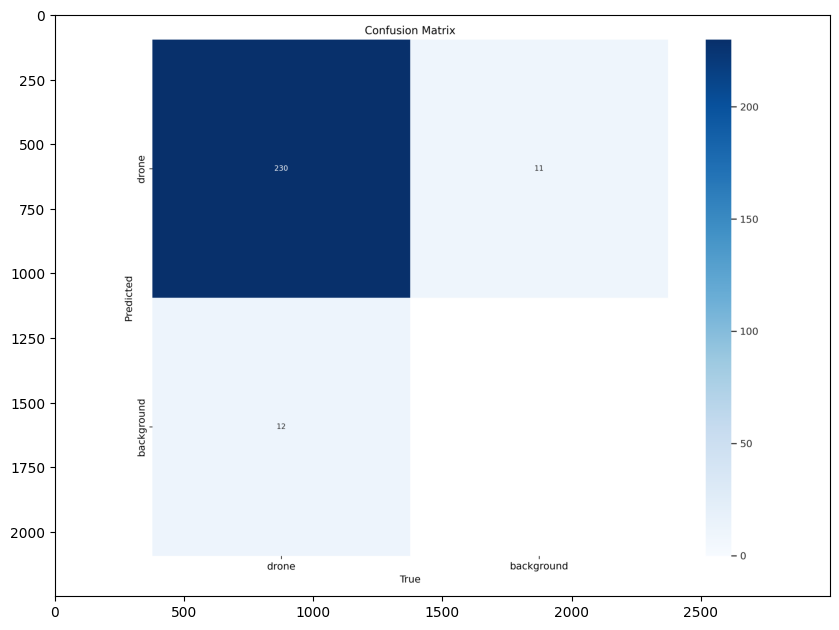

In [ ]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

cnf = Image.open("/content/runs/detect/train/confusion_matrix.png")
plt.figure(figsize = (10,10))
plt.imshow(np.asarray(cnf))

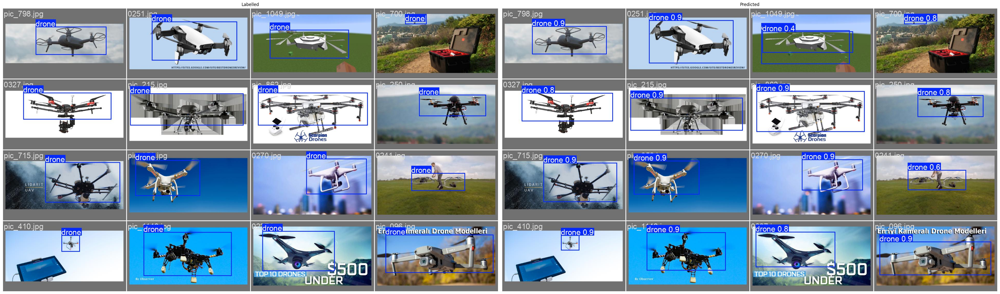

In [ ]:
def show_pred(labelled_path, pred_path):
    plt.figure(figsize = (40,20))
    labelled = Image.open(labelled_path)
    predicted = Image.open(pred_path)
    plt.subplot(121)
    plt.title("Labelled")
    plt.imshow(np.asarray(labelled))
    plt.axis("off")
    plt.subplot(122)
    plt.title("Predicted")
    plt.imshow(np.asarray(predicted))
    plt.axis("off")
    plt.tight_layout()

show_pred("/content/runs/detect/train/val_batch0_labels.jpg", "/content/runs/detect/train/val_batch0_pred.jpg")

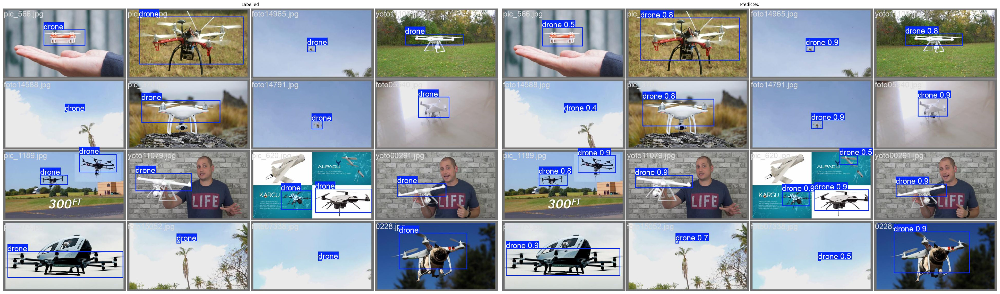

In [ ]:
show_pred("/content/runs/detect/train/val_batch1_labels.jpg", "/content/runs/detect/train/val_batch1_pred.jpg")

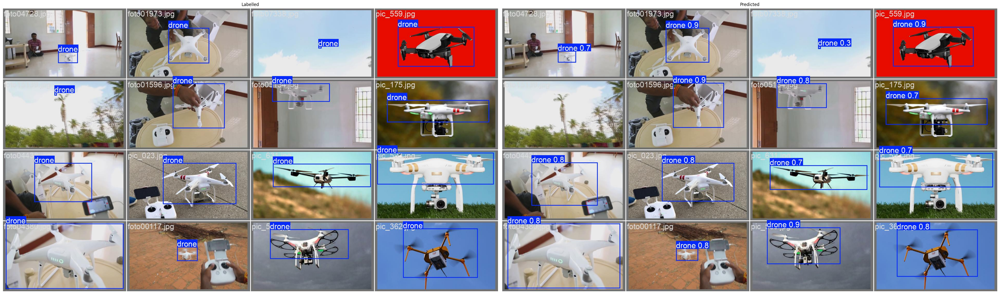

In [ ]:
show_pred("/content/runs/detect/train/val_batch2_labels.jpg", "/content/runs/detect/train/val_batch2_pred.jpg")

In [ ]:
test_results = model.val(data=DATA_DIR/"data.yaml", split="test")

Ultralytics YOLOv8.2.79 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/Data/test/labels... 55 images, 0 backgrounds, 0 corrupt: 100%|██████████| 55/55 [00:00<00:00, 1105.98it/s]

val: New cache created: /content/Data/test/labels.cache



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.18s/it]


                   all         55         63      0.967      0.984      0.993      0.723
Speed: 1.6ms preprocess, 39.4ms inference, 0.4ms loss, 2.8ms postprocess per image
Results saved to runs/detect/train2


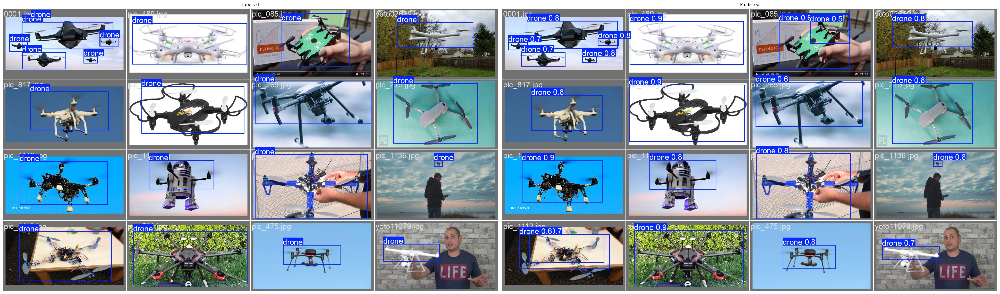

In [ ]:
show_pred("/content/runs/detect/train2/val_batch0_labels.jpg", "/content/runs/detect/train2/val_batch0_pred.jpg")

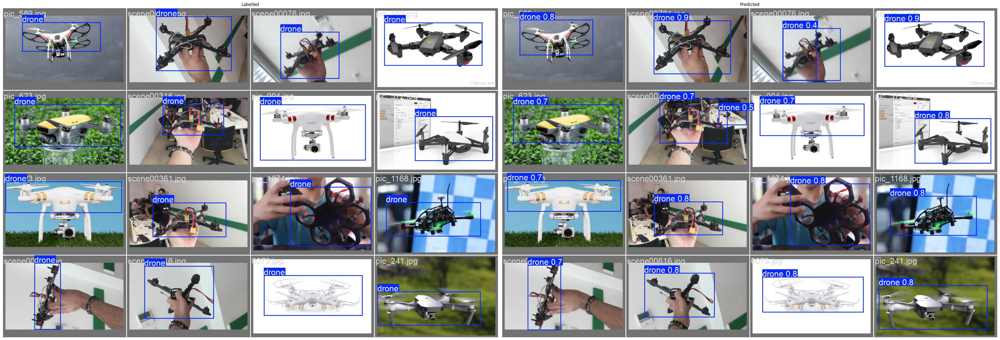

In [ ]:
show_pred("/content/runs/detect/train2/val_batch1_labels.jpg", "/content/runs/detect/train2/val_batch1_pred.jpg")

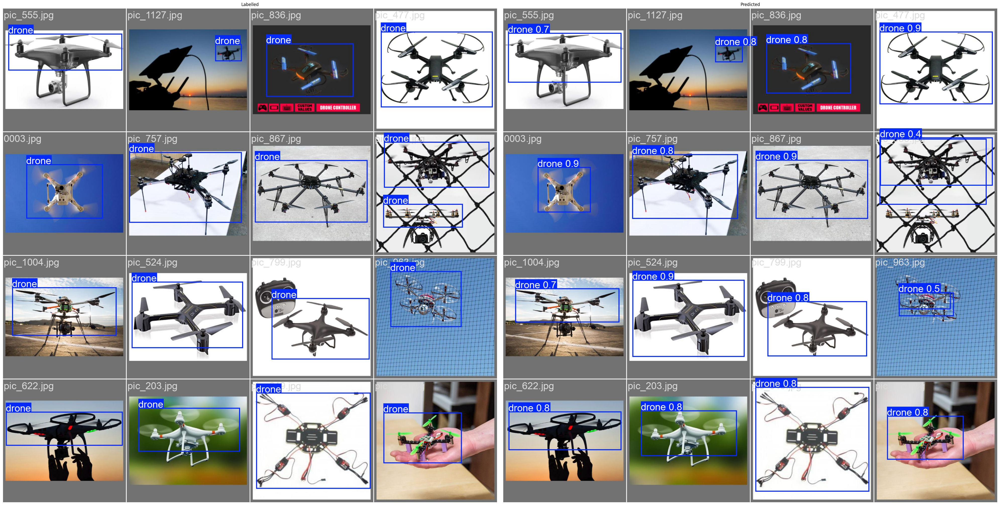

In [ ]:
show_pred("/content/runs/detect/train2/val_batch2_labels.jpg", "/content/runs/detect/train2/val_batch2_pred.jpg")

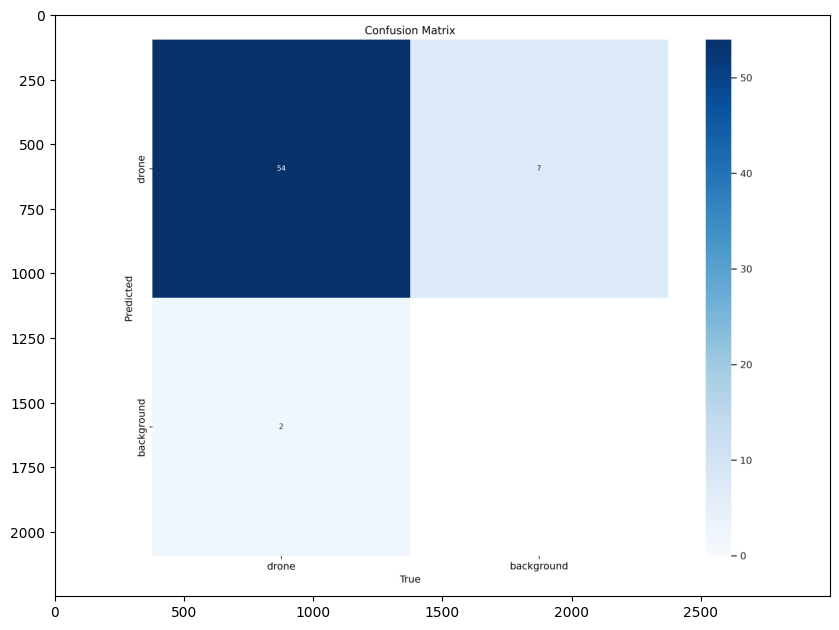

In [ ]:
cnf = Image.open("/content/runs/detect/train2/confusion_matrix.png")
plt.figure(figsize = (10,10))
plt.imshow(np.asarray(cnf))

In [ ]:
!wget https://res.cloudinary.com/engineering-com/image/upload/w_640,h_640,c_limit/Drone_Army_bloy3t.jpg

NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968

In [ ]:
test_image = Image.open("Drone_Army_bloy3t.jpg")
test_image

In [ ]:
test_image_results = model(test_image)[0]

In [ ]:
test_image_results.save("test_image_result.jpg")
Image.open("test_image_result.jpg")

In [ ]:
# Specify the path to your trained model weights
model_weights = 'runs/train/exp/weights/best.pt'

# Copy the model to the output directory
output_dir = '/kaggle/working/'
shutil.copy(model_weights, output_dir)

print(f'Model saved to {output_dir}')

In [ ]:
from ultralytics import YOLO

# Load the YOLOv8 model
model = YOLO("/content/runs/detect/train/weights/best.pt")

# Export the model to TFLite Edge TPU format
model.export(format="edgetpu")  # creates 'yolov8n_full_integer_quant_edgetpu.tflite'


Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs

PyTorch: starting from '/content/runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (21.5 MB)
requirements: Ultralytics requirements ['sng4onnx>=1.0.1', 'onnx_graphsurgeon>=0.3.26', 'onnx>=1.12.0', 'onnx2tf>1.17.5,<=1.22.3', 'onnxslim>=0.1.31', 'tflite_support', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 136.6/136.6 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.4/56.4 kB 252.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 289.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 435.0/435.0 kB 349.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.3/140.3 kB 30

100%|██████████| 1.11M/1.11M [00:00<00:00, 36.0MB/s]
Unzipping calibration_image_sample_data_20x128x128x3_float32.npy.zip to /content/calibration_image_sample_data_20x128x128x3_float32.npy...: 100%|██████████| 1/1 [00:00<00:00, 47.86file/s]


ONNX: starting export with onnx 1.16.2 opset 19...


ONNX: slimming with onnxslim 0.1.34...
ONNX: export success ✅ 1.8s, saved as '/content/runs/detect/train/weights/best.onnx' (42.8 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.22.3...

Automatic generation of each OP name started ========================================
Automatic generation of each OP name complete!

Model loaded ========================================================================

Model conversion started ============================================================
saved_model output started ==========================================================
saved_model output complete!
Float32 tflite output complete!
Float16 tflite output complete!
Dynamic Range Quantization tflite output complete!
Input signature information for quantization
signature_name: serving_default
input_name.0: images shape: (1, 640, 640, 3) dtype: <dtype: 'float32'>
INT8 Quantization tflite output complete!
Full INT8 Quantization tflite output complete!
INT8 Quantization with

'/content/runs/detect/train/weights/best_saved_model/best_full_integer_quant_edgetpu.tflite'